# Urban Mobility Trends Unveiled: A Comprehensive Analysis of Lyft Bikes in San Francisco

Meta Team Members: Divya Dodla (ua03330), Naren Kandregula (pw71937), Sachin Dudam (gg42052)

## Overview

The [Bay Wheels System Data](https://www.lyft.com/bikes/bay-wheels/system-data) provided by Lyft offers a comprehensive dataset capturing the operational details of their bike-sharing program in the San Francisco Bay Area. It encompasses a wide range of information, including trip data, station details, and geospatial coordinates, providing a valuable resource for analyzing urban mobility patterns.This project conducts a comprehensive analysis of urban mobility trends, with a specific focus on Lyft Bikes in San Francisco. The study aims to unveil insights into the usage patterns, preferences, and impact of Lyft Bikes on the transportation landscape in these regions. The code utilizes PySpark for efficient big data processing and Matplotlib/Seaborn for visualizations.

### Motivation

The increasing popularity of bike-sharing systems contributes significantly to sustainable urban transportation. Analyzing the Bay Wheels System Data allows us to gain insights into user behaviors, station utilization, and broader trends, aiding urban planners and policymakers in making informed decisions to enhance the efficiency and accessibility of bike-sharing services.

### Key Objectives

- The analysis covers a comprehensive range of aspects, including data loading and cleaning, feature engineering, exploratory data analysis (EDA), time-related insights, station-related patterns, geolocation analysis, cardinal direction trends, and potential bike availability for users.
- Explore the distribution and density of Lyft Bike stations.
- Analyze ridership patterns, peak usage times(Holidays), and popular routes.
- Assess the overall impact of Lyft Bikes on urban mobility and transportation behavior.
- Utilize machine learning for predicting potential bike availability at specific stations.

### Scope of Analysis

This analysis focuses on uncovering key aspects of Lyft's bike-sharing program in San Francisco. The scope includes exploring station distribution, ridership patterns, factors influencing bike usage, and the overall impact on urban mobility. The analysis leverages data collected from Lyft's bike-sharing program, employing a comprehensive approach to examine various facets of the service. The methodology aims to provide meaningful insights into Lyft Bike's role in shaping urban mobility in San Francisco. Additionally, the dataset presents an opportunity for machine learning applications to predict potential bike availability, contributing to a holistic understanding of Lyft's role in shaping transportation dynamics in the region.

### Findings

The findings from this analysis and machine learning applications will contribute valuable insights to urban planners, policymakers, and transportation enthusiasts interested in understanding and optimizing the dynamics of bike-sharing systems.

Stay tuned for a detailed exploration of Lyft Bike data, shedding light on the intricate facets of urban mobility in these regions.


### 1. Data Collection and Preparation

In [0]:
!pip install haversine

Note: you may need to restart the kernel using dbutils.library.restartPython() to use updated packages.
Note: you may need to restart the kernel using dbutils.library.restartPython() to use updated packages.


In [0]:
from pyspark.sql import SparkSession
from pyspark.sql import functions as F
from pyspark.sql.functions import col, mean, count, unix_timestamp, dayofweek, year, month, dayofmonth, to_date, date_format, hour, avg, concat_ws, udf, lit, when, monotonically_increasing_id, coalesce, expr
from pyspark.sql.window import Window
from pyspark.sql.types import DoubleType, StringType, IntegerType, StructType,StructField

from haversine import haversine, Unit

import pandas as pd
import numpy as np
import math

import matplotlib.pyplot as plt
import seaborn as sns

from pyspark.ml.feature import StringIndexer, VectorAssembler, StandardScaler
from pyspark.ml import Pipeline
from pyspark.ml.classification import LogisticRegression, RandomForestClassifier, MultilayerPerceptronClassifier
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator

In [0]:
# Create a Spark session
spark = SparkSession.builder.appName("Lyft").getOrCreate()

In [0]:
# List of file names
file_names = [
    "202310_baywheels_tripdata.csv",
    "202309_baywheels_tripdata.csv",
    "202308_baywheels_tripdata.csv",
    "202307_baywheels_tripdata.csv",
    "202306_baywheels_tripdata.csv",
    "202305_baywheels_tripdata.csv",
    "202304_baywheels_tripdata.csv",
    "202303_baywheels_tripdata.csv",
    "202302_baywheels_tripdata.csv",
    "202301_baywheels_tripdata.csv",
    "202212_baywheels_tripdata.csv",
    "202210_baywheels_tripdata.csv",
    "202209_baywheels_tripdata.csv",
    "202208_baywheels_tripdata.csv",
    "202207_baywheels_tripdata.csv",
    "202206_baywheels_tripdata.csv",
    "202205_baywheels_tripdata.csv",
    "202204_baywheels_tripdata.csv",
    "202203_baywheels_tripdata.csv",
    "202202_baywheels_tripdata.csv",
    "202201_baywheels_tripdata.csv",
    "202112_baywheels_tripdata.csv",
    "202211_baywheeels_tripdata.csv",
    "202110_baywheels_tripdata.csv",
    "202109_baywheels_tripdata.csv",
    "202108_baywheels_tripdata.csv",
    "202107_baywheels_tripdata.csv",
    "202106_baywheels_tripdata.csv",
    "202105_baywheels_tripdata.csv",
    "202104_baywheels_tripdata.csv",
    "202103_baywheels_tripdata.csv",
    "202102_baywheels_tripdata.csv",
    "202101_baywheels_tripdata.csv"
]

# Read the first file to create the initial DataFrame
main_df = spark.read.option("header", "true").csv(f"dbfs:/FileStore/tables/{file_names[0]}")

# Iterate through the remaining files and union them to the DataFrame
for file_name in file_names[1:]:
    df = spark.read.option("header", "true").csv(f"dbfs:/FileStore/tables/{file_name}")
    main_df = main_df.union(df)

The dataset used in this analysis was retrieved from the Lyft Bay Wheels system data, which can be found at [Lyft Bay Wheels System Data](https://www.lyft.com/bikes/bay-wheels/system-data).

In [0]:
# To Display the combined DataFrame.
display(main_df)

ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
8D28A1986419CBE3,electric_bike,2023-10-20 15:45:35,2023-10-20 15:52:38,null,null,null,null,37.77,-122.41,37.76,-122.41,member
652F4F796934141C,electric_bike,2023-10-19 19:53:35,2023-10-19 20:02:29,null,null,null,null,37.78,-122.39,37.76,-122.4,member
F073C08311A7A378,electric_bike,2023-10-14 21:19:46,2023-10-14 21:35:52,null,null,null,null,37.76,-122.41,37.76,-122.41,member
AC49B13DFA4E6877,electric_bike,2023-10-14 19:15:24,2023-10-14 19:21:30,null,null,null,null,37.76,-122.42,37.75,-122.42,member
2E336B91428B6892,electric_bike,2023-10-14 18:24:03,2023-10-14 18:31:21,null,null,null,null,37.75,-122.42,37.76,-122.42,member
8DE78B84863F5DAA,electric_bike,2023-10-15 01:09:35,2023-10-15 01:15:53,null,null,null,null,37.79,-122.42,37.79,-122.42,member
F0656D308A5BEFD3,electric_bike,2023-10-14 18:42:07,2023-10-14 19:09:07,null,null,null,null,37.76,-122.42,37.76,-122.42,member
DB8C784749BBAE75,electric_bike,2023-10-08 15:25:42,2023-10-08 15:27:11,null,null,null,null,37.76,-122.44,37.76,-122.43,member
3B5A397F7C8E1DA7,electric_bike,2023-10-08 16:43:33,2023-10-08 16:47:52,null,null,null,null,37.76,-122.43,37.77,-122.43,member
76D0C8FD3814A786,electric_bike,2023-10-08 11:30:03,2023-10-08 11:51:51,null,null,null,null,37.77,-122.45,37.77,-122.4,member


In [0]:
main_df.columns

['ride_id',
 'rideable_type',
 'started_at',
 'ended_at',
 'start_station_name',
 'start_station_id',
 'end_station_name',
 'end_station_id',
 'start_lat',
 'start_lng',
 'end_lat',
 'end_lng',
 'member_casual']

##### Feature Descriptions

1. **ride_id:**
   - *Description:* Unique identifier for each bike ride.
   - *Usage:* Used to track and identify individual rides in the dataset.

2. **rideable_type:**
   - *Description:* Type of rideable vehicle used (e.g., electric bike, classic bike, docked bike).
   - *Usage:* Provides information on the type of bike used for each ride.

3. **started_at:**
   - *Description:* Timestamp indicating when the ride started.
   - *Usage:* Used to analyze trends based on the time of day, day of the week, etc.

4. **ended_at:**
   - *Description:* Timestamp indicating when the ride ended.
   - *Usage:* Similar to `started_at`, used for analyzing ride durations and trends.

5. **start_station_name:**
   - *Description:* Name of the station where the ride started.
   - *Usage:* Used to analyze popular starting locations and station-based patterns.

6. **start_station_id:**
   - *Description:* Unique identifier for the station where the ride started.
   - *Usage:* Provides a numeric identifier for the starting station.

7. **end_station_name:**
   - *Description:* Name of the station where the ride ended.
   - *Usage:* Similar to `start_station_name`, used for analyzing end locations.

8. **end_station_id:**
   - *Description:* Unique identifier for the station where the ride ended.
   - *Usage:* Similar to `start_station_id`, provides a numeric identifier for the ending station.

9. **start_lat:**
   - *Description:* Latitude of the starting location.
   - *Usage:* Provides geospatial information for mapping and distance calculations.

10. **start_lng:**
    - *Description:* Longitude of the starting location.
    - *Usage:* Geospatial information similar to `start_lat`.

11. **end_lat:**
    - *Description:* Latitude of the ending location.
    - *Usage:* Geospatial information for analyzing end locations.

12. **end_lng:**
    - *Description:* Longitude of the ending location.
    - *Usage:* Geospatial information similar to `end_lat`.

13. **member_casual:**
    - *Description:* Indicates whether the rider is a member or a casual user.
    - *Usage:* Used for user classification analysis and understanding user behavior patterns.


In [0]:
# Creating a copy of the combined_df DataFrame 
copy_df = main_df.select([F.col(col).alias(col) for col in main_df.columns])

In [0]:
# Checking the total number of rows in the copied DataFrame
copy_df.count()

6625912

In [0]:
# To optimize for performance
copy_df.cache() 

DataFrame[ride_id: string, rideable_type: string, started_at: string, ended_at: string, start_station_name: string, start_station_id: string, end_station_name: string, end_station_id: string, start_lat: string, start_lng: string, end_lat: string, end_lng: string, member_casual: string]

In [0]:
# Printing the data types of features in the copied DataFrame
for column, dtype in copy_df.dtypes:
    print(f"{column}: {dtype}")

ride_id: string
rideable_type: string
started_at: string
ended_at: string
start_station_name: string
start_station_id: string
end_station_name: string
end_station_id: string
start_lat: string
start_lng: string
end_lat: string
end_lng: string
member_casual: string


In [0]:
# Check for null values in each column
for column in copy_df.columns:
    null_count = copy_df.filter(col(column).isNull()).count()
    print(f"Null count in {column}: {null_count}")

Null count in ride_id: 0
Null count in rideable_type: 0
Null count in started_at: 0
Null count in ended_at: 0
Null count in start_station_name: 1102952
Null count in start_station_id: 1107206
Null count in end_station_name: 1249852
Null count in end_station_id: 1254188
Null count in start_lat: 0
Null count in start_lng: 0
Null count in end_lat: 6478
Null count in end_lng: 6478
Null count in member_casual: 0


In [0]:
# For "start_station_name", "end_station_name", "start_station_id", "end_station_id" and "member_casual", Best strategy is to replace null values with a string like "Unknown" using the fillna method.
copy_df = copy_df.fillna("Unknown", subset=["start_station_name", "end_station_name", "start_station_id", "end_station_id", "member_casual"])

# Null values are relatively low for "end_lat" and "end_lng", so we can safely remove these rows
copy_df = copy_df.dropna(subset=["end_lat","end_lng"])

##Feature Engineering & Exploratory Data Analysis (EDA)

### 2. Potential Canceled Rides Analysis

In [0]:
# Convert the "started_at" and "ended_at" column to a timestamp type
copy_df = copy_df.withColumn("started_at", copy_df["started_at"].cast("timestamp"))
copy_df = copy_df.withColumn("ended_at", copy_df["ended_at"].cast("timestamp"))

# Calculate the duration of the ride in seconds
copy_df = copy_df.withColumn("ride_duration(sec)", (unix_timestamp("ended_at") - unix_timestamp("started_at")))

# Set a time cutoff for potential canceled rides (e.g., 5 minutes)
cancellation_time_cutoff = 300  # 5 minute in seconds

# Filter rides with duration below the cutoff
cancelled_rides = copy_df.filter((col("ride_duration(sec)") <= cancellation_time_cutoff) & (col("start_station_name") == col("end_station_name")))

# Print the number of rides that might be canceled
print(f"Number of potentially canceled rides: {cancelled_rides.count()}")

Number of potentially canceled rides: 311875


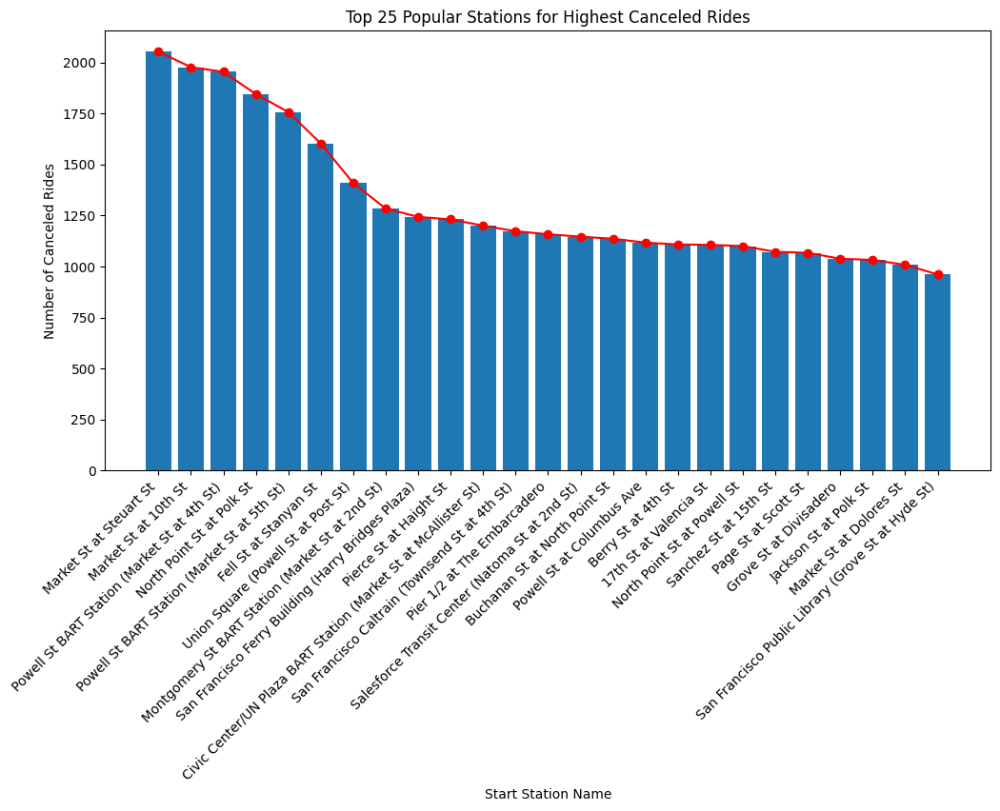

In [0]:
# Get the count of canceled rides for each start station
popular_cancelled_stations = (
    cancelled_rides
    .groupBy("start_station_name")
    .count()
    .orderBy(col("count").desc())
)

popular_cancelled_stations = popular_cancelled_stations.filter(col("start_station_name") != "Unknown")

# Select the top 25 popular cancelled stations
top25_cancelled_stations = popular_cancelled_stations.limit(25)

# Convert to Pandas DataFrame
top25_cancelled_stations_pd = top25_cancelled_stations.toPandas()

# Plot the graph for the top 50 stations
plt.figure(figsize=(12, 6))
plt.bar(top25_cancelled_stations_pd['start_station_name'], top25_cancelled_stations_pd['count'])

# Draw a line touching the tops of the bars
plt.plot(
    top25_cancelled_stations_pd['start_station_name'], 
    top25_cancelled_stations_pd['count'], 
    marker='o', 
    linestyle='-', 
    color='r',  
    label='Line on Top'
)

plt.title('Top 25 Popular Stations for Highest Canceled Rides')
plt.xlabel('Start Station Name')
plt.ylabel('Number of Canceled Rides')
plt.xticks(rotation=45, ha='right')
plt.show()

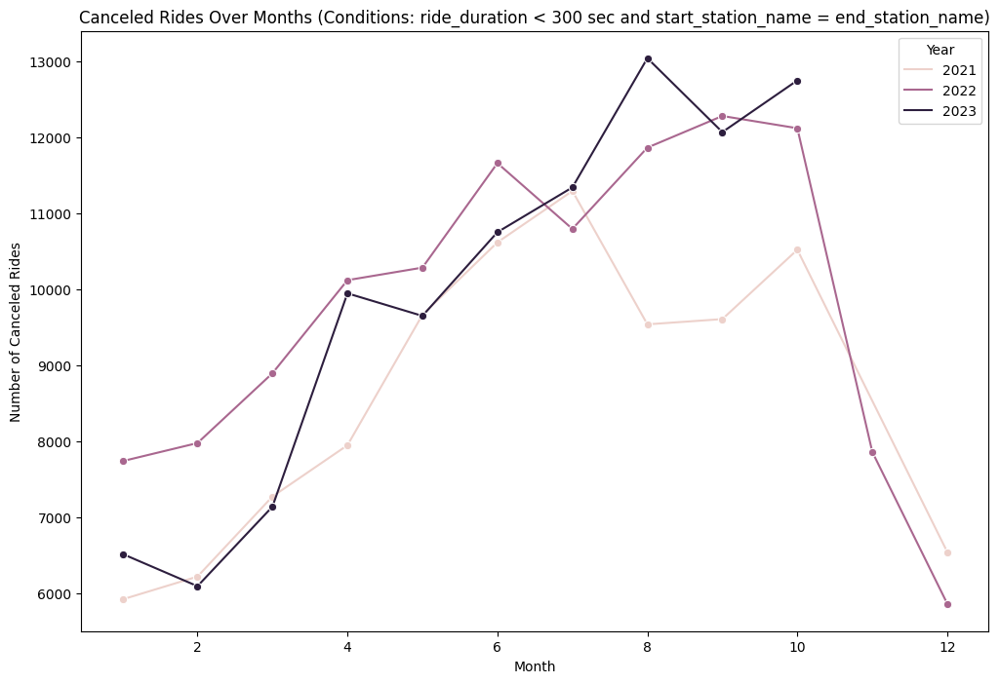

In [0]:
# Group by year-month to get the count of canceled rides
cancelled_rides_count = (
    cancelled_rides
    .groupBy(year("started_at").alias("year"), month("started_at").alias("month"))
    .count()
    .orderBy("year", "month")
)

# Convert to Pandas for visualization
cancelled_rides_pd = cancelled_rides_count.toPandas()

# Set the figure size
plt.figure(figsize=(12, 8))

# Plot the graph
sns.lineplot(data=cancelled_rides_pd, x="month", y="count", hue="year", marker='o')

# Set labels and title
plt.xlabel('Month')
plt.ylabel('Number of Canceled Rides')
plt.title('Canceled Rides Over Months (Conditions: ride_duration < 300 sec and start_station_name = end_station_name)')

# Show the legend
plt.legend(title='Year', loc='upper right')

# Show the plot
plt.show()

In [0]:
# Discard potentially canceled rides from the copy_df DataFrame
copy_df = copy_df.filter(
    (col("ride_duration(sec)") >= cancellation_time_cutoff) |
    ((col("ride_duration(sec)") < cancellation_time_cutoff) & (col("start_station_name") != col("end_station_name")))
)

# Checking the total number of rows in the filtered DataFrame
copy_df.count()

6308154

Discarding potentially canceled rides helps in creating more accurate visualizations and prevents outliers that might impact machine learning models, ensuring a more meaningful analysis of the ride data.

### 3. Station Analysis

In [0]:
# Convert latitude and longitude columns to DoubleType
copy_df = copy_df.withColumn("start_lat", col("start_lat").cast("double"))
copy_df = copy_df.withColumn("start_lng", col("start_lng").cast("double"))
copy_df = copy_df.withColumn("end_lat", col("end_lat").cast("double"))
copy_df = copy_df.withColumn("end_lng", col("end_lng").cast("double"))

# Filter out unknown data under start_station_name and end_station_name
filtered_df = copy_df.filter(
    (col("start_station_name") != "Unknown") &
    (col("end_station_name") != "Unknown")
)

# Displaying a map to visualize the distribution of Lyft Bike stations
display(filtered_df.select("start_station_name","end_station_name", "start_lat", "start_lng", "end_lat", "end_lng").distinct())

start_station_name,end_station_name,start_lat,start_lng,end_lat,end_lng
Folsom St at 19th St,4th St at 16th St,37.760639833333336,-122.41483333333333,37.76704457969368,-122.39083349704742
4th St at Long Bridge St,4th St at 16th St,37.773747921,-122.391826153,37.76704457969368,-122.39083349704742
Duboce Park,Laguna St at Hayes St,37.769200166666664,-122.43410233333333,37.7762475,-122.4262025
Grove St at Divisadero,Laguna St at Hayes St,37.776028,-122.437568,37.7762475,-122.4262025
2nd St at Townsend St,Laguna St at Hayes St,37.780335666666666,-122.390334,37.7762475,-122.4262025
Battery St at Filbert St,Berry St at 4th St,37.80203516666667,-122.40177366666667,37.77599270441184,-122.39300568626935
17th St at Valencia St,4th St at 16th St,37.7632515,-122.42200316666667,37.76704457969368,-122.39083349704742
S Van Ness Ave at Market St,4th St at 16th St,37.774814,-122.418954,37.76704457969368,-122.39083349704742
Brannan St at Colin P Kelly Jr St,Howard St at 8th St,37.782405833333335,-122.391653,37.7765126,-122.4113061
4th St at 16th St,4th St at 16th St,37.76684383333333,-122.390752,37.76704457969368,-122.39083349704742


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

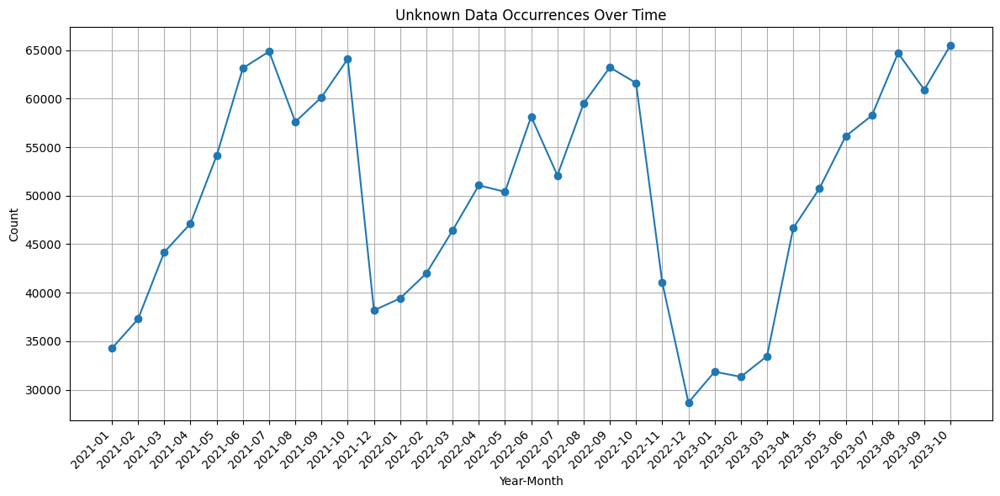

In [0]:
# Filter data for unknown start or end stations
unknown_data_df = copy_df.filter(
    (col("start_station_name") == "Unknown") | 
    (col("end_station_name") == "Unknown")
)

# Extract year and month from the 'started_at' column
unknown_data_df = unknown_data_df.withColumn("year_month", col("started_at").substr(1, 7))

# Group by year_month and count the occurrences
unknown_data_counts = unknown_data_df.groupBy("year_month").count().orderBy("year_month")

# Convert PySpark DataFrame to Pandas for local plotting
unknown_data_counts_pd = unknown_data_counts.toPandas()

# Plot the line chart
plt.figure(figsize=(12, 6))
plt.plot(unknown_data_counts_pd["year_month"], unknown_data_counts_pd["count"], marker='o')
plt.title("Unknown Data Occurrences Over Time")
plt.xlabel("Year-Month")
plt.ylabel("Count")
plt.xticks(rotation=45, ha="right")
plt.grid(True)
plt.tight_layout()
plt.show()

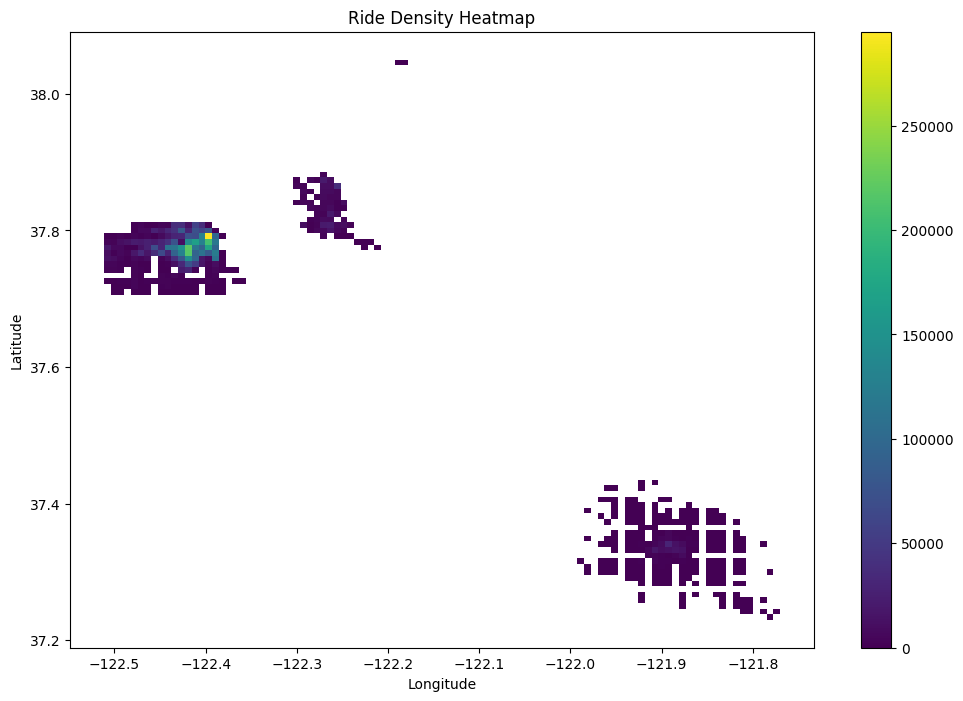

In [0]:
# Set the figure size
plt.figure(figsize=(12, 8))

# Create a 2D histogram (heatmap) of ride density
sns.histplot(copy_df.toPandas(), x='start_lng', y='start_lat', bins=100, cmap='viridis', cbar=True)

# Set labels and title
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Ride Density Heatmap')

# Show the plot
plt.show()

In [0]:
# Count total number of distinct stations in start and end station together
total_distinct_stations = filtered_df.select("start_station_name").union(filtered_df.select("end_station_name")).distinct().count()
print("Total number of distinct stations:", total_distinct_stations)

Total number of distinct stations: 603


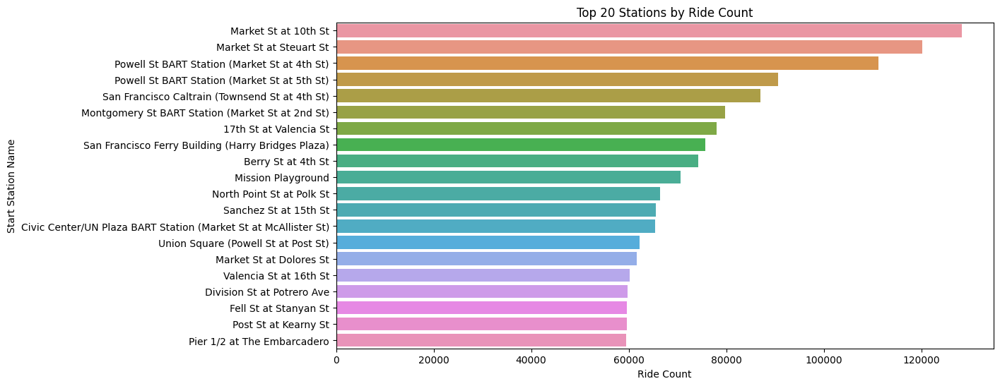

In [0]:
# Plotting the distribution and density of stations
# Union of start and end stations and group by start station name to get counts
stations_union = filtered_df.select("start_station_name").union(filtered_df.select("end_station_name"))

# Count occurrences for each start station and convert to Pandas DataFrame
station_counts = stations_union.groupBy("start_station_name").count().toPandas()

# Sort stations by count in descending order
station_counts = station_counts.sort_values(by="count", ascending=False)

# Plot the top N stations
top_n = 20
plt.figure(figsize=(12, 6))
sns.barplot(x="count", y="start_station_name", data=station_counts.head(top_n))
plt.title(f"Top {top_n} Stations by Ride Count")
plt.xlabel("Ride Count")
plt.ylabel("Start Station Name")
plt.show()

In [0]:
# Analyzing the popularity of stations
station_popularity = stations_union.groupBy("start_station_name").count().orderBy("count", ascending=False)

# Ranking end stations based on ride counts
station_ranking = station_popularity.withColumn("rank", F.dense_rank().over(Window.orderBy(F.desc("count"))))
display(station_ranking)

start_station_name,count,rank
Market St at 10th St,128379,1
Market St at Steuart St,120152,2
Powell St BART Station (Market St at 4th St),111292,3
Powell St BART Station (Market St at 5th St),90707,4
San Francisco Caltrain (Townsend St at 4th St),86984,5
Montgomery St BART Station (Market St at 2nd St),79805,6
17th St at Valencia St,78090,7
San Francisco Ferry Building (Harry Bridges Plaza),75741,8
Berry St at 4th St,74297,9
Mission Playground,70637,10


### 4. Ridership Patterns and Impact Assesment

In [0]:
# Extract day, weekday, month, year
copy_df = copy_df.withColumn("hour_of_day", hour("started_at"))
copy_df = copy_df.withColumn("day_of_week", dayofweek("started_at"))
copy_df = copy_df.withColumn("day_of_month", dayofmonth("started_at"))
copy_df = copy_df.withColumn("month", month("started_at"))
copy_df = copy_df.withColumn("year", year("started_at"))

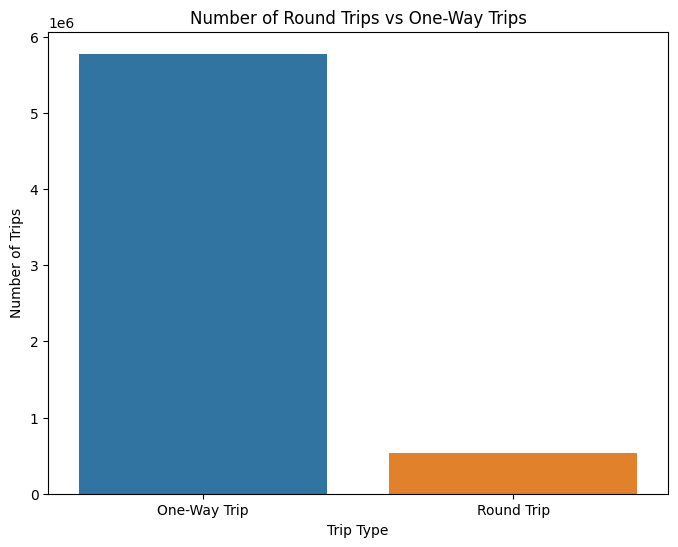

In [0]:
# Create a new column 'trip_type' to classify rides as round trips or one-way trips
trip_type_counts = copy_df.withColumn(
    "trip_type",
    when(col("start_station_name") == col("end_station_name"), "Round Trip").otherwise("One-Way Trip")
)

# Group by the 'trip_type' column and count occurrences
trip_type_counts = trip_type_counts.groupBy("trip_type").count()

# Convert to Pandas for visualization
trip_type_counts_pd = trip_type_counts.toPandas()

# Set the figure size
plt.figure(figsize=(8, 6))

# Plot the bar graph
sns.barplot(x="trip_type", y="count", data=trip_type_counts_pd)

# Set labels and title
plt.xlabel('Trip Type')
plt.ylabel('Number of Trips')
plt.title('Number of Round Trips vs One-Way Trips')

# Show the plot
plt.show()

In [0]:
# Group by start and end stations and calculate the count for each route
popular_routes = filtered_df.groupBy("start_station_name", "end_station_name").count().orderBy(col("count").desc())

display(popular_routes)

start_station_name,end_station_name,count
Fell St at Stanyan St,Fell St at Stanyan St,2838
Market St at 10th St,Powell St BART Station (Market St at 4th St),2527
Pier 1/2 at The Embarcadero,North Point St at Powell St,2500
Market St at 10th St,Powell St BART Station (Market St at 5th St),2311
Market St at Steuart St,Berry St at 4th St,2293
The Embarcadero at Sansome St,Market St at Steuart St,2263
Mason St at Halleck St,Mason St at Halleck St,2228
Powell St BART Station (Market St at 5th St),Market St at 10th St,2116
Market St at 10th St,Civic Center/UN Plaza BART Station (Market St at McAllister St),2070
Market St at Steuart St,North Point St at Powell St,2033


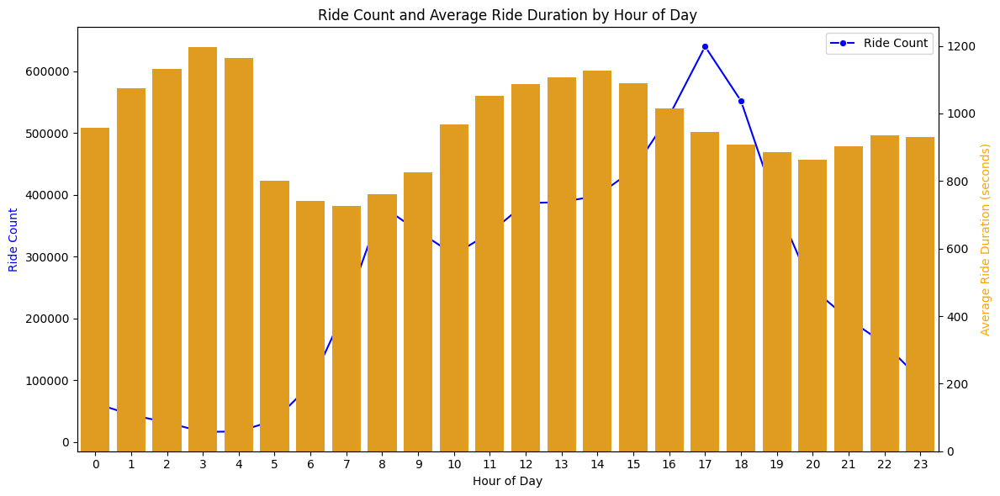

In [0]:
# Group by the hour_of_day, calculate the count and average ride duration
rides_per_hour = copy_df.groupBy("hour_of_day").agg(
    count("*").alias("ride_count"),
    avg("ride_duration(sec)").alias("avg_ride_duration_sec")
)

# Convert the PySpark DataFrame to a Pandas DataFrame for local plotting
rides_per_hour_pd = rides_per_hour.toPandas()

# Set up the figure with two subplots
fig, ax1 = plt.subplots(figsize=(12, 6))

# Plot the ride count on the left y-axis
sns.lineplot(x="hour_of_day", y="ride_count", data=rides_per_hour_pd, ax=ax1, color='b', label='Ride Count', marker='o')
ax1.set_ylabel('Ride Count', color='b')
ax1.set_xlabel('Hour of Day')

# Create a second y-axis to plot average ride duration
ax2 = ax1.twinx()
sns.barplot(x="hour_of_day", y="avg_ride_duration_sec", data=rides_per_hour_pd, ax=ax2, color='orange', label='Average Ride Duration')
ax2.set_ylabel('Average Ride Duration (seconds)', color='orange')

# Set title and legend
plt.title('Ride Count and Average Ride Duration by Hour of Day')
fig.tight_layout()

# Show the plot
plt.show()

In [0]:
category_groups = copy_df.groupBy('member_casual').count()
category_groups.show()

+-------------+-------+
|member_casual|  count|
+-------------+-------+
|       casual|2702435|
|       member|3605719|
+-------------+-------+



In [0]:
category_groups = copy_df.groupBy('rideable_type').count()
category_groups.show()

+-------------+-------+
|rideable_type|  count|
+-------------+-------+
|electric_bike|4197496|
| classic_bike|2085406|
|  docked_bike|  25252|
+-------------+-------+



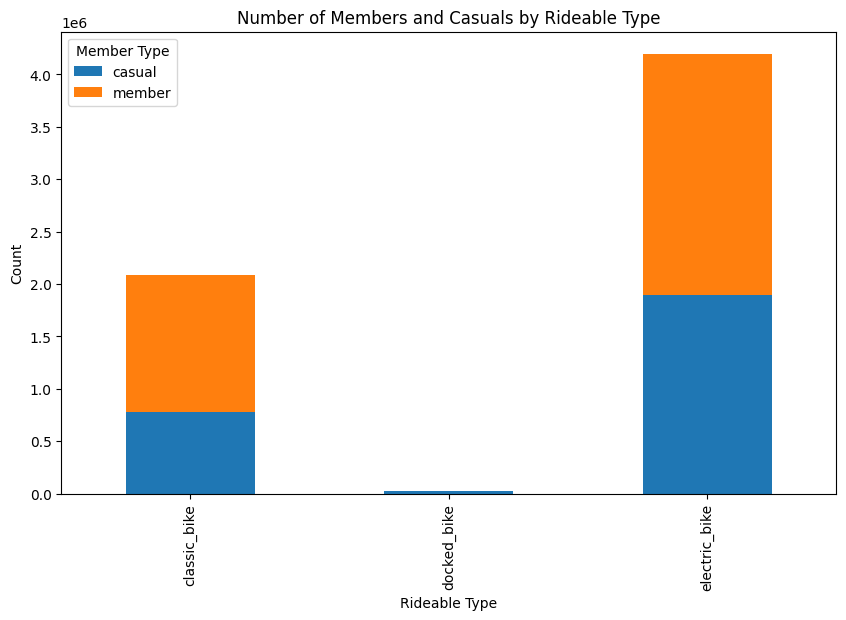

In [0]:
# Create a Pandas DataFrame for local plotting
df_copy_pd = copy_df.toPandas()

# Count the number of members and casuals for each rideable type
count_data = df_copy_pd.groupby(['rideable_type', 'member_casual']).size().unstack().reset_index()

# Plot the histogram
count_data.plot(x='rideable_type', kind='bar', stacked=True, figsize=(10, 6))
plt.xlabel('Rideable Type')
plt.ylabel('Count')
plt.title('Number of Members and Casuals by Rideable Type')
plt.legend(title='Member Type')
plt.show()

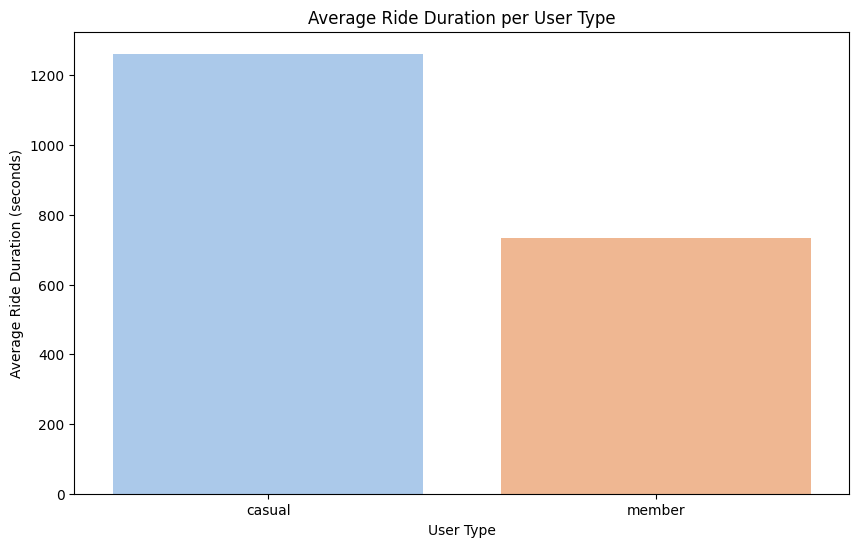

In [0]:
# Calculate the average number of rides per user
avg_rides_per_user = copy_df.groupBy("member_casual").agg(count("ride_id").alias("total_rides"), avg("ride_duration(sec)").alias("avg_ride_duration"))

# Convert to Pandas for visualization
avg_rides_per_user_pd = avg_rides_per_user.toPandas()

# Set the figure size
plt.figure(figsize=(10, 6))

# Plot the average duration of rides per user
sns.barplot(x="member_casual", y="avg_ride_duration", data=avg_rides_per_user_pd, palette="pastel")
plt.xlabel('User Type')
plt.ylabel('Average Ride Duration (seconds)')
plt.title('Average Ride Duration per User Type')

# Show the plot
plt.show()

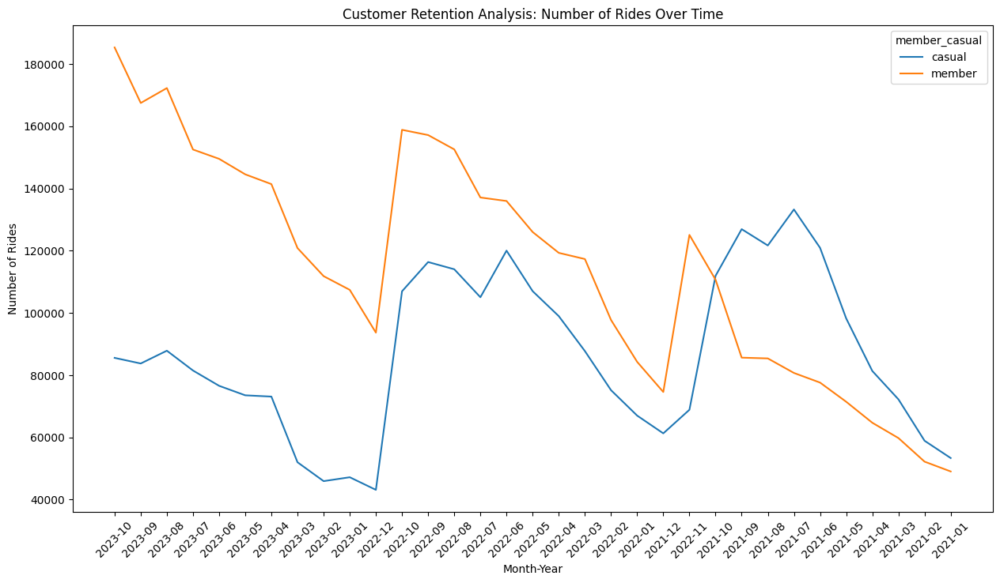

In [0]:
# Extract relevant columns for the analysis
time_analysis_df = copy_df.select("started_at", "member_casual")

# Extract month and year
time_analysis_df = time_analysis_df.withColumn("month", date_format("started_at", "yyyy-MM"))
time_analysis_df = time_analysis_df.withColumn("year", date_format("started_at", "yyyy"))

# Group by time dimensions and user type, count the number of rides
rides_over_time = time_analysis_df.groupBy("year", "month", "member_casual").count()

# Convert to Pandas for visualization
rides_over_time_pd = rides_over_time.toPandas()

# Set the figure size
plt.figure(figsize=(15, 8))

# Plot the trend over time for both members and casual users
sns.lineplot(x="month", y="count", hue="member_casual", data=rides_over_time_pd)

# Set labels and title
plt.xlabel('Month-Year')
plt.ylabel('Number of Rides')
plt.title('Customer Retention Analysis: Number of Rides Over Time')

# Rotate x-axis labels to prevent overlap
plt.xticks(rotation=45)

# Show the plot
plt.show()

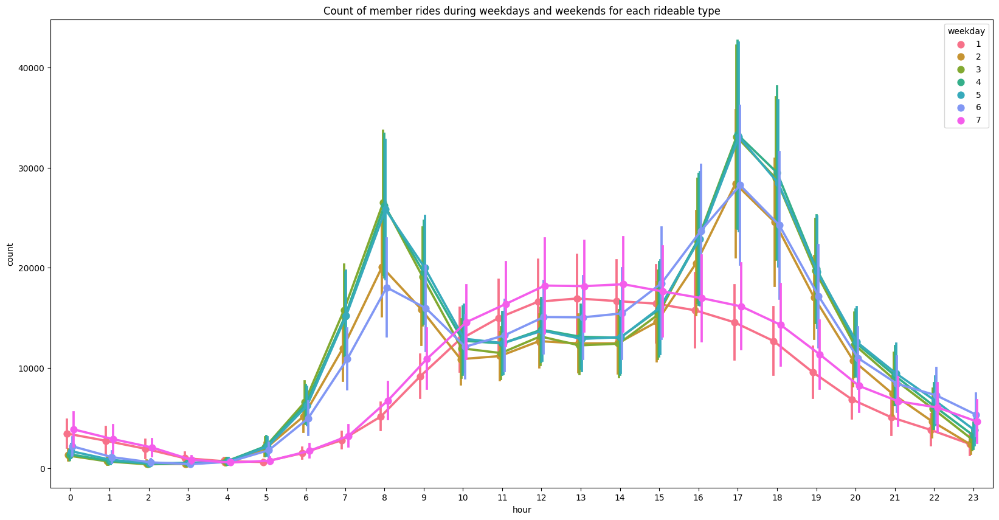

In [0]:
# Filter data for member and casual
member_df = copy_df.filter(copy_df['member_casual'] == 'member')

# Perform necessary transformations for member
member_df = member_df.withColumn("hour", hour("started_at").cast(IntegerType()))
member_df = member_df.withColumn("weekday", dayofweek("started_at").cast(IntegerType()))
member_counts_member = member_df.groupBy("hour", "weekday", "rideable_type").count().toPandas()

# Get the number of unique weekdays
num_weekdays = len(member_counts_member['weekday'].unique())

# Choose markers based on the number of unique weekdays
markers = sns.color_palette("husl", num_weekdays)

# Plotting for member
fig, ax = plt.subplots(figsize=(20, 10))
sns.pointplot(data=member_counts_member, x='hour', y='count', hue='weekday', ax=ax, palette=markers, dodge=True)
ax.set(title='Count of member rides during weekdays and weekends for each rideable type')
plt.show()

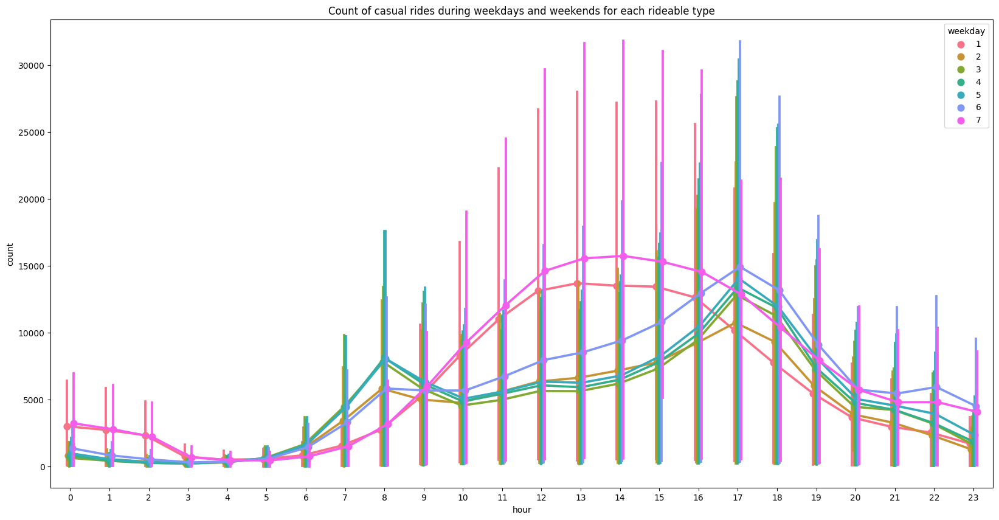

In [0]:
# Filter data for member and casual
casual_df = copy_df.filter(copy_df['member_casual'] == 'casual')

# Perform necessary transformations for casual
casual_df = casual_df.withColumn("hour", hour("started_at").cast(IntegerType()))
casual_df = casual_df.withColumn("weekday", dayofweek("started_at").cast(IntegerType()))
member_counts_casual = casual_df.groupBy("hour", "weekday", "rideable_type").count().toPandas()

# Get the number of unique weekdays
num_weekdays_casual = len(member_counts_casual['weekday'].unique())

# Choose markers based on the number of unique weekdays
markers_casual = sns.color_palette("husl", num_weekdays_casual)

# Plotting for casual
fig, ax = plt.subplots(figsize=(20, 10))
sns.pointplot(data=member_counts_casual, x='hour', y='count', hue='weekday', ax=ax, palette=markers_casual, dodge=True)
ax.set(title='Count of casual rides during weekdays and weekends for each rideable type')
plt.show()

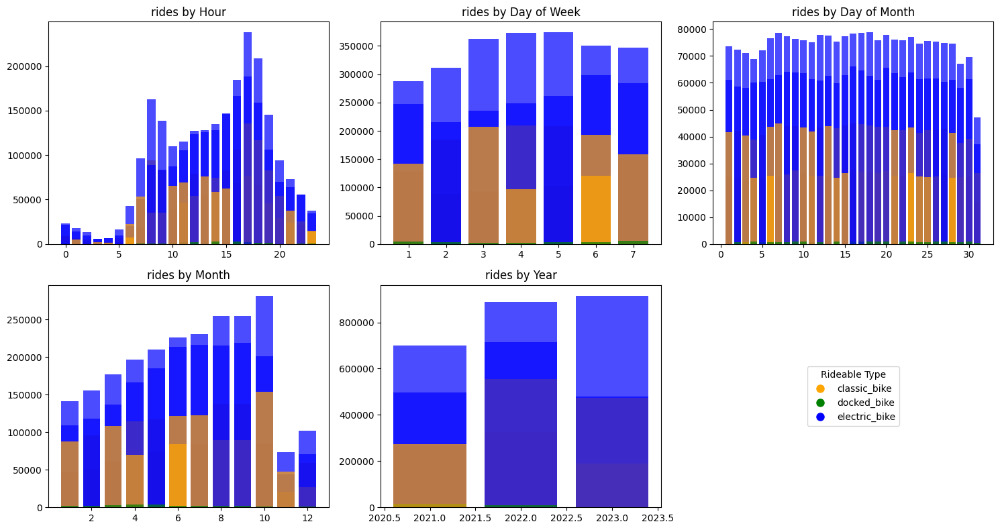

In [0]:
# Calculate rides based on different time dimensions
rides_by_hour = copy_df.groupBy("hour_of_day", "member_casual", "rideable_type").count().orderBy("hour_of_day")
rides_by_day_of_week = copy_df.groupBy("day_of_week", "member_casual", "rideable_type").count().orderBy("day_of_week")
rides_by_day_of_month = copy_df.groupBy("day_of_month", "member_casual", "rideable_type").count().orderBy("day_of_month")
rides_by_month = copy_df.groupBy("month", "member_casual", "rideable_type").count().orderBy("month")
rides_by_year = copy_df.groupBy("year", "member_casual", "rideable_type").count().orderBy("year")

# Convert PySpark DataFrames to Pandas for local plotting
rides_hour_pd = rides_by_hour.toPandas()
rides_day_of_week_pd = rides_by_day_of_week.toPandas()
rides_day_of_month_pd = rides_by_day_of_month.toPandas()
rides_month_pd = rides_by_month.toPandas()
rides_year_pd = rides_by_year.toPandas()

# Plotting the results
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 8))

# Bar chart for rides by hour
axes[0, 0].bar(rides_hour_pd['hour_of_day'], rides_hour_pd['count'], color=rides_hour_pd['rideable_type'].map({'electric_bike': 'blue', 'classic_bike': 'orange', 'docked_bike': 'green'}), alpha=0.7)
axes[0, 0].set_title('rides by Hour')

# Bar chart for rides by day of week
axes[0, 1].bar(rides_day_of_week_pd['day_of_week'], rides_day_of_week_pd['count'], color=rides_day_of_week_pd['rideable_type'].map({'electric_bike': 'blue', 'classic_bike': 'orange', 'docked_bike': 'green'}), alpha=0.7)
axes[0, 1].set_title('rides by Day of Week')

# Bar chart for rides by day of month
axes[0, 2].bar(rides_day_of_month_pd['day_of_month'], rides_day_of_month_pd['count'], color=rides_day_of_month_pd['rideable_type'].map({'electric_bike': 'blue', 'classic_bike': 'orange', 'docked_bike': 'green'}), alpha=0.7)
axes[0, 2].set_title('rides by Day of Month')

# Bar chart for rides by month
axes[1, 0].bar(rides_month_pd['month'], rides_month_pd['count'], color=rides_month_pd['rideable_type'].map({'electric_bike': 'blue', 'classic_bike': 'orange', 'docked_bike': 'green'}), alpha=0.7)
axes[1, 0].set_title('rides by Month')

# Bar chart for rides by year
axes[1, 1].bar(rides_year_pd['year'], rides_year_pd['count'], color=rides_year_pd['rideable_type'].map({'electric_bike': 'blue', 'classic_bike': 'orange', 'docked_bike': 'green'}), alpha=0.7)
axes[1, 1].set_title('rides by Year')

# Add legend
axes[1, 2].axis('off')
legend_labels = rides_hour_pd['rideable_type'].unique()
colors = ['orange', 'green', 'blue']
legend_handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10) for color in colors]
axes[1, 2].legend(legend_handles, legend_labels, title='Rideable Type', loc='center')

# Adjust layout
plt.tight_layout()
plt.show()

### 5. Geolocation and Distance Analysis:

In [0]:
# Define a UDF to calculate distance using haversine
@udf(returnType=DoubleType())
def calculate_distance(start_lat, start_lng, end_lat, end_lng):
    start_point = (float(start_lat), float(start_lng))
    end_point = (float(end_lat), float(end_lng))
    
    return haversine(start_point, end_point, unit=Unit.MILES)

# Apply the UDF to calculate distance and add a new column "distance" to the DataFrame
copy_df = copy_df.withColumn("distance(miles)", calculate_distance("start_lat", "start_lng", "end_lat", "end_lng"))

# Show the updated DataFrame with the distance column
# display(copy_df)

The idea for geolocation distance calculation using the Haversine formula is derived from the article ["Calculating Distance Between Two Geolocations in Python"](https://towardsdatascience.com/calculating-distance-between-two-geolocations-in-python-26ad3afe287b). The Haversine formula is applied through a User-Defined Function (UDF) to calculate the distance between start and end points, resulting in the addition of a new column "distance(miles)" to the DataFrame.

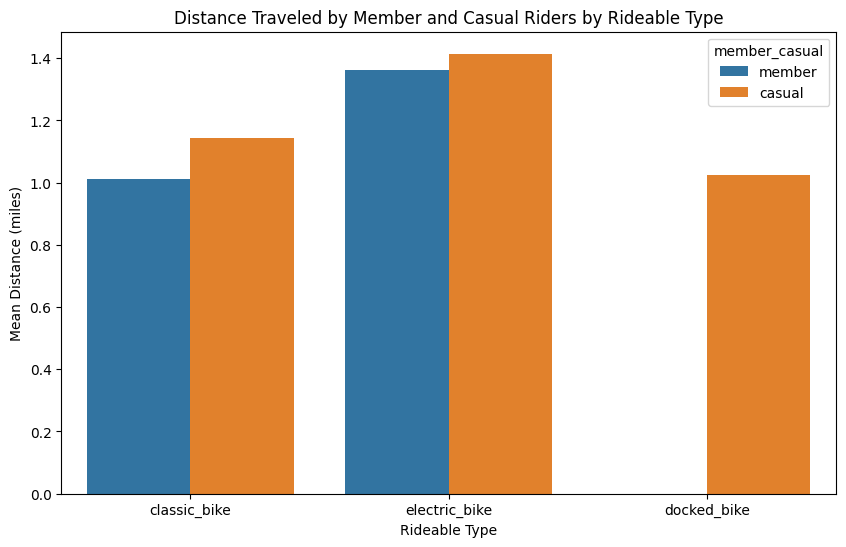

In [0]:
plot_data = copy_df[['distance(miles)', 'member_casual', 'rideable_type']]

# Group by 'rideable_type' and 'member_casual', then calculate the mean distance for each group
grouped_data = (
    plot_data
    .groupBy('rideable_type', 'member_casual')
    .agg(avg('distance(miles)').alias('mean_distance'))
)

# Convert PySpark DataFrame to Pandas for plotting
pandas_grouped_data = grouped_data.toPandas()

# Plotting using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(x='rideable_type', y='mean_distance', hue='member_casual', data=pandas_grouped_data)
plt.title('Distance Traveled by Member and Casual Riders by Rideable Type')
plt.xlabel('Rideable Type')
plt.ylabel('Mean Distance (miles)')
plt.show()

In [0]:
# Calculate average speed and add a new column "average_speed"
copy_df = copy_df.withColumn("average_speed(mps)", col("distance(miles)") / col("ride_duration(sec)"))

# To drop null values
copy_df = copy_df.na.drop()

# Show the updated DataFrame with the average_speed column
# display(copy_df)

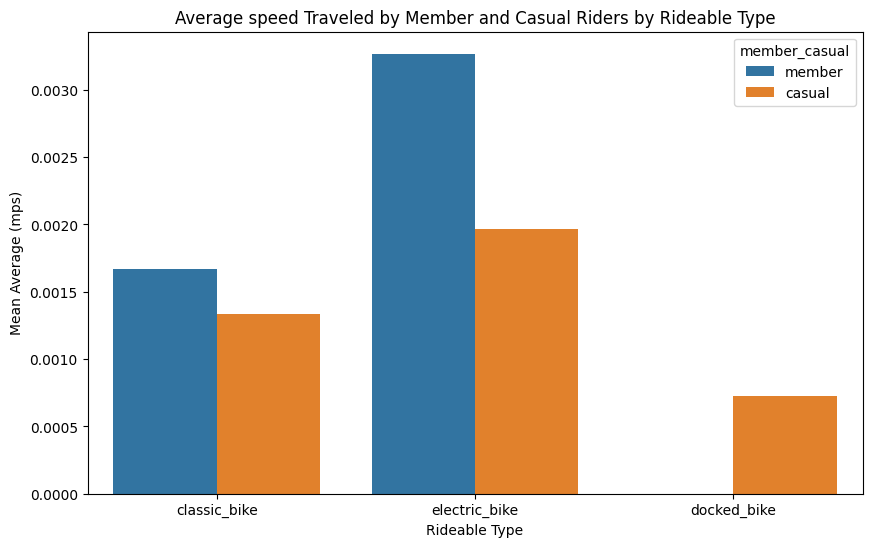

In [0]:
plot_data = copy_df[['average_speed(mps)', 'member_casual', 'rideable_type']]

# Group by 'rideable_type' and 'member_casual', then calculate the mean distance for each group
grouped_data = (
    plot_data
    .groupBy('rideable_type', 'member_casual')
    .agg(avg('average_speed(mps)').alias('mean_average'))
)

# Convert PySpark DataFrame to Pandas for plotting
pandas_grouped_data = grouped_data.toPandas()

# Plotting using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(x='rideable_type', y='mean_average', hue='member_casual', data=pandas_grouped_data)
plt.title('Average speed Traveled by Member and Casual Riders by Rideable Type')
plt.xlabel('Rideable Type')
plt.ylabel('Mean Average (mps)')
plt.show()

### 6. Cardinal Direction Analysis:

In [0]:
# Define a UDF to calculate bearing
@udf(returnType=DoubleType())
def calculate_bearing(start_lat, start_lng, end_lat, end_lng):
    start_lat, start_lng, end_lat, end_lng = map(math.radians, [start_lat, start_lng, end_lat, end_lng])
    
    dlon = end_lng - start_lng
    x = math.sin(dlon) * math.cos(end_lat)
    y = math.cos(start_lat) * math.sin(end_lat) - (math.sin(start_lat) * math.cos(end_lat) * math.cos(dlon))

    bearing = math.atan2(x, y)
    
    # Convert bearing from radians to degrees
    bearing = math.degrees(bearing)
    
    # Ensure the result is in the range [0, 360)
    bearing = (bearing + 360) % 360
    
    return bearing

# Apply the UDF to calculate bearing and add a new column "bearing" to the DataFrame
copy_df = copy_df.withColumn("bearing", calculate_bearing("start_lat", "start_lng", "end_lat", "end_lng"))

# Show the updated DataFrame with the bearing column
# display(copy_df)

In [0]:
# Define a UDF to convert bearing to cardinal directions
@udf(returnType=StringType())
def bearing_to_cardinal(bearing):
    if bearing is None:
        return None

    directions = ["N", "NE", "E", "SE", "S", "SW", "W", "NW", "N"]

    # Convert bearing to index in the directions list
    index = round(bearing / 45) % 8

    return directions[index]

# Apply the UDF to convert bearing and add a new column "cardinal_direction" to the DataFrame
copy_df = copy_df.withColumn("cardinal_direction", bearing_to_cardinal("bearing"))

# Show the updated DataFrame with the cardinal_direction column
# display(copy_df)

- In this section, a User-Defined Function (UDF) is defined to calculate the bearing between two geographical coordinates. The idea is inspired by the method described in this reference: [mapscaping](https://mapscaping.com/how-to-calculate-bearing-between-two-coordinates/#:~:text=In%20Microsoft%20Excel%2C%20you%20can,x%2Daxis%20and%20the%20point.).

- The concept of bearing is crucial for understanding the direction of movement between two points. It provides valuable information about the orientation of rides, which can be insightful for analyzing patterns and trends in the dataset.

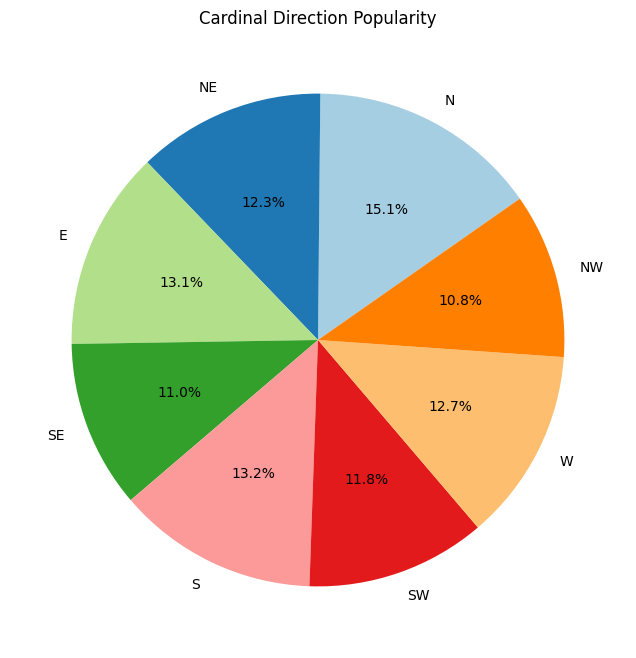

In [0]:
# Group by cardinal_direction and count the occurrences
direction_popularity = copy_df.groupBy("cardinal_direction").agg(count("*").alias("direction_count"))

# Convert the PySpark DataFrame to a Pandas DataFrame for local plotting
direction_popularity_pd = direction_popularity.toPandas()

direction_angles = {
    'N': 0,
    'NE': 45,
    'E': 90,
    'SE': 135,
    'S': 180,
    'SW': 225,
    'W': 270,
    'NW': 315
}

# Order the DataFrame based on cardinal directions
direction_popularity_pd['angle'] = direction_popularity_pd['cardinal_direction'].map(direction_angles)
direction_popularity_pd = direction_popularity_pd.sort_values(by='angle')

# Plot a pie chart
plt.figure(figsize=(8, 8))
plt.pie(direction_popularity_pd['direction_count'], labels=direction_popularity_pd['cardinal_direction'], autopct='%1.1f%%', startangle=35, colors=plt.cm.Paired.colors)

plt.title('Cardinal Direction Popularity')
plt.show()

### 7. Adding Holiday feature w.r.t date to "copy_df"

In [0]:
# Define the schema for the DataFrame
schema = StructType([StructField("Date", StringType(), True)])

# List of holiday dates
holiday_dates = [
    "2021-01-01", "2021-01-18", "2021-02-15", "2021-03-31", "2021-04-04",
    "2021-05-09", "2021-05-31", "2021-06-20", "2021-07-04", "2021-09-06",
    "2021-11-11", "2021-11-25", "2021-11-26", "2021-12-25", "2021-12-31",
    "2022-01-01", "2022-01-17", "2022-02-21", "2022-03-31", "2022-04-17",
    "2022-05-08", "2022-05-30", "2022-06-19", "2022-07-04", "2022-09-05",
    "2022-11-11", "2022-11-24", "2022-11-25", "2022-12-25", "2022-12-26",
    "2023-01-01", "2023-01-02", "2023-01-16", "2023-02-20", "2023-03-31",
    "2023-04-09", "2023-05-14", "2023-05-29", "2023-06-18", "2023-06-19",
    "2023-07-04", "2023-09-04", "2023-11-10", "2023-11-23", "2023-11-24",
    "2023-12-25"
]

# Create a DataFrame with the holiday dates
holiday_df = spark.createDataFrame([(date,) for date in holiday_dates], schema=schema)

# Add a column "Holiday" and set all values to 1
holiday_df = holiday_df.withColumn("Holiday", lit(1))
holiday_df = holiday_df.withColumn("H_day_of_week", dayofweek("Date"))
holiday_df = holiday_df.withColumn("H_day_of_month", dayofmonth("Date"))
holiday_df = holiday_df.withColumn("H_month", month("Date"))
holiday_df = holiday_df.withColumn("H_year", year("Date"))

Reference: [Office Holidays - California, USA](https://www.officeholidays.com/countries/usa/california)

In [0]:
# Perform a left join
copy_df = copy_df.join(
    holiday_df,
    (copy_df["day_of_month"] == holiday_df["H_day_of_month"]) &
    (copy_df["day_of_week"] == holiday_df["H_day_of_week"]) &
    (copy_df["month"] == holiday_df["H_month"]) &
    (copy_df["year"] == holiday_df["H_year"]),
    "left"
)

# Fill null values in the "Holiday" column with 0
copy_df = copy_df.withColumn("Holiday", when(col("Holiday").isNull(), 0).otherwise(col("Holiday")))
copy_df = copy_df.withColumn("Holiday", when((col("day_of_week") == 1) | (col("day_of_week") == 7), 1).otherwise(col("Holiday")))
copy_df = copy_df.drop("Date", "H_day_of_week", "H_day_of_month", "H_month", "H_year")

/root/.ipykernel/1047/command-2651398745873122-887258802:9: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.catplot(x='month', y='ride_count', hue='Holiday', col='rideable_type', row='member_casual',


<Figure size 1500x800 with 0 Axes>

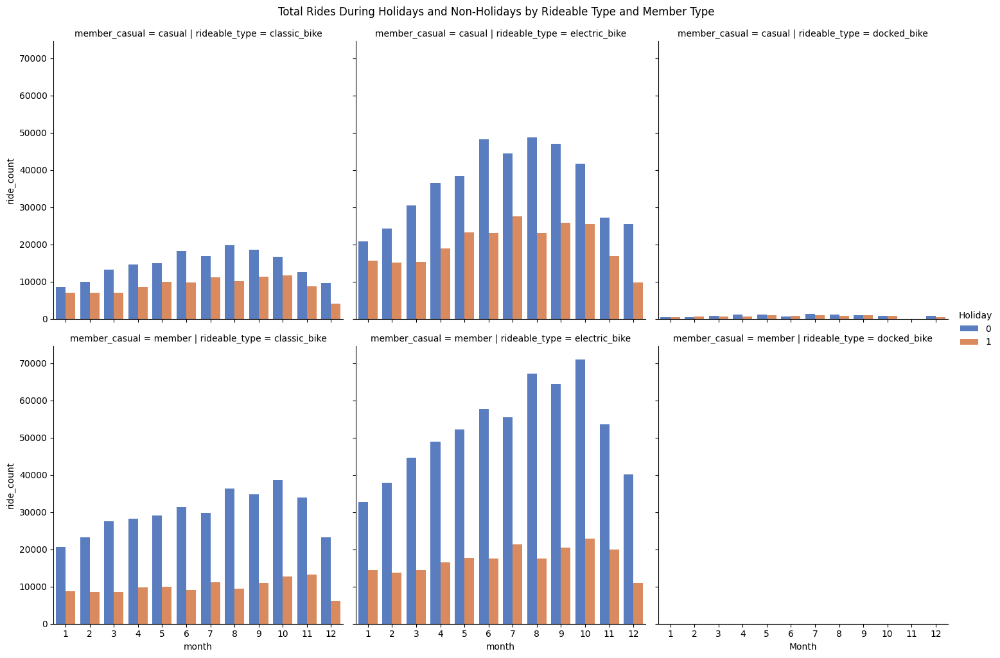

In [0]:
# Group by 'year', 'month', 'rideable_type', 'member_casual', and 'Holiday' and count the number of rides
grouped_data = copy_df.groupby(['year', 'month', 'rideable_type', 'member_casual', 'Holiday']).count().withColumnRenamed('count', 'ride_count')

# Convert PySpark DataFrame to Pandas DataFrame for plotting
grouped_data_pandas = grouped_data.toPandas()

# Plotting using seaborn
plt.figure(figsize=(15, 8))
sns.catplot(x='month', y='ride_count', hue='Holiday', col='rideable_type', row='member_casual',
            kind='bar', data=grouped_data_pandas, ci=None, height=5, aspect=1, palette='muted')
plt.suptitle('Total Rides During Holidays and Non-Holidays by Rideable Type and Member Type', y=1.02)
plt.xlabel('Month')
plt.ylabel('Total Rides')
plt.show()

###8. Co-relation Matrix

/root/.ipykernel/1047/command-3485737398067340-3108577273:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = copy_df.toPandas().corr()


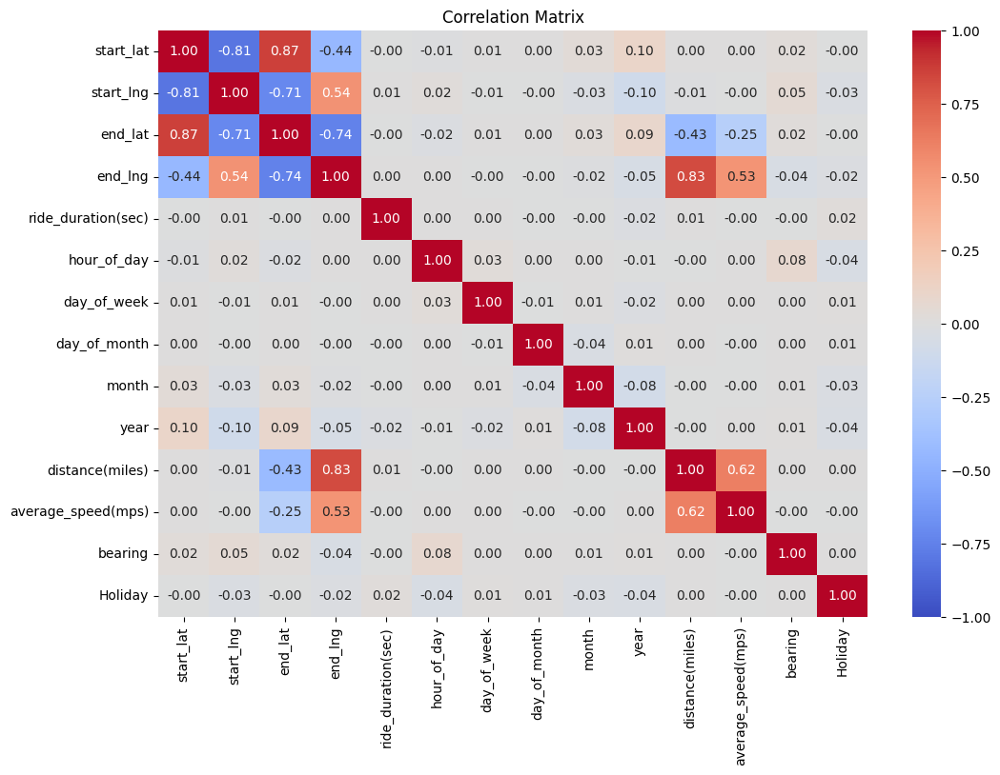

In [0]:
# Calculate the correlation matrix
correlation_matrix = copy_df.toPandas().corr()

# Plotting the correlation matrix as a heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.show()

### 9. Machine Learning

In [0]:
# Duplicate DataFrame copy_df as temp_df
temp_df = copy_df.select([F.col(col).alias(col) for col in copy_df.columns])

In [0]:
# To filter out the unknown data under "start_station_name" and "end_station_name".
temp_df = temp_df.filter(
    (col("start_station_name") != "Unknown") &
    (col("end_station_name") != "Unknown")
)

temp_df.count()

4649938

In [0]:
# Dropping columns
temp_df = temp_df.drop("hour_of_day","day_of_week", "day_of_month", "month", "year")

# Extract the necessary columns from 'started_at'
temp_df = temp_df.withColumn('start_hour_of_day', hour('started_at'))
temp_df = temp_df.withColumn('start_day_of_week', dayofweek('started_at'))
temp_df = temp_df.withColumn('start_day_of_month', dayofmonth('started_at'))
temp_df = temp_df.withColumn('start_month', month('started_at'))
temp_df = temp_df.withColumn('start_year', year('started_at'))

# Extract the necessary columns from 'ended_at'
temp_df = temp_df.withColumn('end_hour_of_day', hour('ended_at'))
temp_df = temp_df.withColumn('end_day_of_week', dayofweek('ended_at'))
temp_df = temp_df.withColumn('end_day_of_month', dayofmonth('ended_at'))
temp_df = temp_df.withColumn('end_month', month('ended_at'))
temp_df = temp_df.withColumn('end_year', year('ended_at'))

In [0]:
ride_start = temp_df.groupby('start_station_name','start_year', 'start_month', 'start_day_of_month', 'start_day_of_week', 'start_hour_of_day').agg(count('start_hour_of_day'))

ride_end = temp_df.groupby('end_station_name','end_year', 'end_month', 'end_day_of_month', 'end_day_of_week', 'end_hour_of_day').agg(count('end_hour_of_day'))


In [0]:
#Joining ride_start and ride_end dataframes to get ride hourly ride start count and hourly ride end ccolumns into one table

rides_outer_join = ride_start.join(ride_end,(ride_start["start_station_name"] == ride_end["end_station_name"]) & 
                                  (ride_start["start_year"] == ride_end["end_year"]) &
                                  (ride_start["start_month"] == ride_end["end_month"]) &
                                  (ride_start["start_day_of_month"] == ride_end["end_day_of_month"]) &
                                  (ride_start["start_day_of_week"] == ride_end["end_day_of_week"]) &
                                  (ride_start["start_hour_of_day"] == ride_end["end_hour_of_day"])
                                   , "outer")
# display(rides_outer_join)

In [0]:
rides = rides_outer_join.withColumn('start_station_name', coalesce(col('start_station_name'), col('end_station_name')))\
                    .withColumn('start_year', coalesce(col('start_year'), col('end_year')))\
                    .withColumn('start_month', coalesce(col('start_month'), col('end_month')))\
                    .withColumn('start_day_of_month', coalesce(col('start_day_of_month'), col('end_day_of_month')))\
                    .withColumn('start_day_of_week', coalesce(col('start_day_of_week'), col('end_day_of_week')))\
                    .withColumn('start_hour_of_day', coalesce(col('start_hour_of_day'), col('end_hour_of_day')))\
                    .withColumn('end_station_name', coalesce(col('end_station_name'), col('start_station_name')))\
                    .withColumn('end_year', coalesce(col('end_year'), col('start_year')))\
                    .withColumn('end_month', coalesce(col('end_month'), col('start_month')))\
                    .withColumn('end_day_of_month', coalesce(col('end_day_of_month'), col('start_day_of_month')))\
                    .withColumn('end_day_of_week', coalesce(col('end_day_of_week'), col('start_day_of_week')))\
                    .withColumn('end_hour_of_day', coalesce(col('end_hour_of_day'), col('start_hour_of_day')))\
                    .withColumn('total_start_rides_count_per_hour', when(col('count(start_hour_of_day)').isNull(), 0).otherwise(col('count(start_hour_of_day)')))\
                    .withColumn('total_end_rides_count_per_hour',  when(col('count(end_hour_of_day)').isNull(), 0).otherwise(col('count(end_hour_of_day)')))

In [0]:
#Dropping duplicate columns
rides = rides.drop('end_station_name','end_year', 'end_month', 'end_day_of_month', 'end_day_of_week', 'end_hour_of_day', 'count(start_hour_of_day)', 'count(end_hour_of_day)')

In [0]:
rides = rides.withColumn('avail_difference', col('total_end_rides_count_per_hour')-col('total_start_rides_count_per_hour'))\
    .withColumn('ride_availability', when(col('avail_difference') > 0, 1).otherwise(0))

In [0]:
final_copy_df = rides.alias("rides_avail_difference") \
    .join(copy_df.alias("copy_df"),
          (col("rides_avail_difference.start_station_name") == col("copy_df.start_station_name")) &
          (col("rides_avail_difference.start_year") == col("copy_df.year")) &
          (col("rides_avail_difference.start_month") == col("copy_df.month")) &
          (col("rides_avail_difference.start_day_of_month") == col("copy_df.day_of_month")) &
          (col("rides_avail_difference.start_day_of_week") == col("copy_df.day_of_week")) &
          (col("rides_avail_difference.start_hour_of_day") == col("copy_df.hour_of_day")),
          "inner").select("copy_df.*", "rides_avail_difference.ride_availability")
display(final_copy_df)

ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual,ride_duration(sec),hour_of_day,day_of_week,day_of_month,month,year,distance(miles),average_speed(mps),bearing,cardinal_direction,Holiday,ride_availability
C7400B2D4D65C43C,electric_bike,2023-05-25T16:58:32Z,2023-05-25T17:14:12Z,*Howard St at Grace St,SF-K24-3,Market St at Steuart St,SF-E29-2,37.77460716666667,-122.41390233333334,37.794525,-122.3948805,member,940,16,5,25,5,2023,1.7241837449918407,0.0018342380265870646,37.03849863932578,NE,0,0
35748415F8DA002D,electric_bike,2023-05-25T16:53:28Z,2023-05-25T17:02:48Z,*Howard St at Grace St,SF-K24-3,Page St at Scott St,SF-K19,37.774578,-122.41389766666667,37.772354,-122.4358575,member,560,16,5,25,5,2023,1.2091210082749795,0.0021591446576338918,262.70542261632556,W,0,0
AD83DB738E860E5A,classic_bike,2023-05-25T16:36:55Z,2023-05-25T16:51:33Z,*Howard St at Grace St,SF-K24-3,Jackson St at Polk St,SF-E23,37.7744791,-122.4139142,37.79416044174933,-122.42156758904456,member,878,16,5,25,5,2023,1.422622175277843,0.001620298605100049,342.91863273633925,N,0,0
3ED7FF779E394E88,electric_bike,2023-05-25T16:08:48Z,2023-05-25T16:10:53Z,*Howard St at Grace St,SF-K24-3,Folsom St at 9th St,SF-K25,37.774491,-122.41393133333334,37.7737172,-122.4116467,member,125,16,5,25,5,2023,0.13574440128047038,0.0010859552102437631,113.19428539648197,SE,0,0
3BFE3C63CBF859BD,electric_bike,2023-05-25T16:22:14Z,2023-05-25T16:30:02Z,*Howard St at Grace St,SF-K24-3,Unknown,Unknown,37.7745005,-122.4139155,37.76,-122.41,member,468,16,5,25,5,2023,1.0244597292932305,0.002189016515583826,167.94948682378174,S,0,0
F091654CAE67B4D3,electric_bike,2023-05-25T16:51:46Z,2023-05-25T17:10:43Z,*Howard St at Grace St,SF-K24-3,Unknown,Unknown,37.7745395,-122.413911,37.74,-122.42,member,1137,16,5,25,5,2023,2.4095204476136067,0.002119191246801765,187.93650152613316,S,0,0
54346DD4AE4E5C72,classic_bike,2023-05-26T01:55:19Z,2023-05-26T01:56:35Z,*Howard St at Grace St,SF-K24-3,Folsom St at 9th St,SF-K25,37.7744791,-122.4139142,37.7737172,-122.4116467,member,76,1,6,26,5,2023,0.1345610501864768,0.0017705401340325894,113.02941539504775,SE,0,0
506EA7E0589BCFA6,electric_bike,2023-05-29T07:50:40Z,2023-05-29T07:56:46Z,*Howard St at Grace St,SF-K24-3,Father Alfred E Boeddeker Park,SF-H25,37.7745695,-122.41393966666666,37.7840775,-122.411926,member,366,7,2,29,5,2023,0.6660803045696055,0.001819891542539906,9.5020829721268,N,1,0
0ECB6F865A08EA66,electric_bike,2023-05-31T06:35:23Z,2023-05-31T06:45:00Z,*Howard St at Grace St,SF-K24-3,Hospital St at Mariposa St,SF-N30,37.77454016666667,-122.41387,37.764783,-122.3908972,member,577,6,4,31,5,2023,1.424348206948903,0.0024685410865665563,118.24223316413247,SE,0,0
A7ED0573B2BAE9DB,electric_bike,2023-06-03T09:28:53Z,2023-06-03T09:31:22Z,*Howard St at Grace St,SF-K24-3,Market St at 10th St,SF-J23-1,37.774538,-122.41389516666666,37.776619,-122.417385,member,149,9,7,3,6,2023,0.23874197098668568,0.0016022951072931925,307.03259829857416,NW,1,0


In [0]:
ml_df = final_copy_df.select("start_station_name","rideable_type", "start_lat", "start_lng", "end_lat", "end_lng", "member_casual", "ride_duration(sec)", "hour_of_day", "day_of_week", "day_of_month", "month", "year", "distance(miles)", "average_speed(mps)", "bearing","Holiday", "ride_availability")

In [0]:
# Create a StringIndexer
indexer = StringIndexer(inputCol="start_station_name", outputCol="start_station_index")

# Create a pipeline
pipeline = Pipeline(stages=[indexer])

# Fit and transform the data
new_ml_df = pipeline.fit(ml_df).transform(ml_df)

# Show the updated DataFrame
# display(new_ml_df)

In [0]:
# Convert "member_casual" values to numerical columns
new_ml_df = new_ml_df.withColumn("is_member", expr("CASE WHEN member_casual = 'member' THEN 1 ELSE 0 END")) \
                       .withColumn("is_casual", expr("CASE WHEN member_casual = 'casual' THEN 1 ELSE 0 END"))

# display(new_ml_df)

In [0]:
# Create new columns based on "ridable_type" values
new_ml_df = (
    new_ml_df
    .withColumn("is_electric_bike", expr("CASE WHEN rideable_type = 'electric_bike' THEN 1 ELSE 0 END"))
    .withColumn("is_classic_bike", expr("CASE WHEN rideable_type = 'classic_bike' THEN 1 ELSE 0 END"))
    .withColumn("is_docked_bike", expr("CASE WHEN rideable_type = 'docked_bike' THEN 1 ELSE 0 END"))
)

# Drop the original "ridable_type" column
new_ml_df = new_ml_df.drop("rideable_type")
new_ml_df = new_ml_df.drop("start_station_name")
new_ml_df = new_ml_df.drop("member_casual")

# Show the transformed DataFrame
display(new_ml_df)

#### Machine Learning Pipeline Execution

##### Note: The machine learning portion is placed in a separate notebook due to automatic cluster dispatching and Databricks Community edition limitations, which is incured due to a high load than usual. 
##### Please refer to the dedicated machine learning notebook for detailed insights into model training and evaluation.

In [0]:
# List of columns excluding "ride_availability"
input_cols = [col for col in new_ml_df.columns if col != "ride_availability"]

# Create a vector assembler
vector_assembler = VectorAssembler(
    inputCols=input_cols,
    outputCol="features"
)

# Create a standard scaler
scaler = StandardScaler(inputCol="features", outputCol="scaled_features", withStd=True, withMean=True)

# Initialize the logistic regression model
logistic_reg = LogisticRegression(featuresCol="features", labelCol="ride_availability", maxIter=100, tol=1e-5)

# Create a pipeline
pipeline = Pipeline(stages=[vector_assembler, scaler, logistic_reg])

# Split your data into training and testing sets
(train_data, test_data) = new_ml_df.randomSplit([0.8, 0.2], seed=123)

# Cache the training data to avoid redundant computations
train_data.cache()

# Fit the pipeline to the training data
model = pipeline.fit(train_data)

# Make predictions on the test data
predictions = model.transform(test_data)

# Evaluate the model (e.g., using BinaryClassificationEvaluator)
evaluator = BinaryClassificationEvaluator(labelCol="ride_availability")
accuracy = evaluator.evaluate(predictions, {evaluator.metricName: "areaUnderROC"})
print(f"Area under ROC curve: {accuracy}")

# Evaluate the model
evaluator = MulticlassClassificationEvaluator(labelCol="ride_availability", metricName="accuracy")
accuracy = evaluator.evaluate(predictions)
print(f"Accuracy: {accuracy}")

---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-2651398745873101>, line 2
      1 # List of columns excluding "ride_availability"
----> 2 input_cols = [col for col in new_ml_df.columns if col != "ride_availability"]
      4 # Create a vector assembler
      5 vector_assembler = VectorAssembler(
      6     inputCols=input_cols,
      7     outputCol="features"
      8 )

NameError: name 'new_ml_df' is not defined

In [0]:
# List of columns excluding "ride_availability"
input_cols = [col for col in new_ml_df.columns if col != "ride_availability"]

# Create a vector assembler
vector_assembler = VectorAssembler(
    inputCols=input_cols,
    outputCol="features"
)

# Initialize the Random Forest model
random_forest = RandomForestClassifier(featuresCol="features", labelCol="ride_availability", maxDepth=10, numTrees=100, maxBins=600)

# Create a pipeline
pipeline = Pipeline(stages=[vector_assembler, random_forest])

# Split your data into training and testing sets
(train_data, test_data) = new_ml_df.randomSplit([0.8, 0.2], seed=123)

# Cache the training data to avoid redundant computations
train_data.cache()

# Fit the pipeline to the training data
model = pipeline.fit(train_data)

# Make predictions on the test data
predictions = model.transform(test_data)

# Evaluate the model (e.g., using BinaryClassificationEvaluator)
evaluator = BinaryClassificationEvaluator(labelCol="ride_availability", metricName="areaUnderROC")
accuracy = evaluator.evaluate(predictions)
print(f"Area under ROC curve: {accuracy}")

# Evaluate the model
evaluator = MulticlassClassificationEvaluator(labelCol="ride_availability", metricName="accuracy")
accuracy = evaluator.evaluate(predictions)
print(f"Accuracy: {accuracy}")

---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-2651398745873100>, line 2
      1 # List of columns excluding "ride_availability"
----> 2 input_cols = [col for col in new_ml_df.columns if col != "ride_availability"]
      4 # Create a vector assembler
      5 vector_assembler = VectorAssembler(
      6     inputCols=input_cols,
      7     outputCol="features"
      8 )

NameError: name 'new_ml_df' is not defined

In [0]:
# List of columns excluding "ride_availability"
input_cols = [col for col in new_ml_df.columns if col != "ride_availability"]

# Create a vector assembler
vector_assembler = VectorAssembler(inputCols=input_cols, outputCol="features")

# Initialize the Multilayer Perceptron model
layers = [len(input_cols), 15, 10, 5, 2] 
mlp = MultilayerPerceptronClassifier(featuresCol="features", labelCol="ride_availability", layers=layers, seed=123)

# Create a pipeline
pipeline = Pipeline(stages=[vector_assembler, mlp])

# Split your data into training and testing sets
(train_data, test_data) = new_ml_df.randomSplit([0.8, 0.2], seed=123)

# Fit the pipeline to the training data
model = pipeline.fit(train_data)

# Make predictions on the test data
predictions = model.transform(test_data)

# Evaluate the model
evaluator = BinaryClassificationEvaluator(labelCol="ride_availability", metricName="areaUnderROC")
accuracy = evaluator.evaluate(predictions)
print(f"Area under ROC curve for Multilayer Perceptron Classifier: {accuracy}")

# Evaluate the model
evaluator = MulticlassClassificationEvaluator(labelCol="ride_availability", metricName="accuracy")
accuracy = evaluator.evaluate(predictions)
print(f"Accuracy for Multilayer Perceptron Classifier: {accuracy}")

---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-2651398745873099>, line 2
      1 # List of columns excluding "ride_availability"
----> 2 input_cols = [col for col in new_ml_df.columns if col != "ride_availability"]
      4 # Create a vector assembler
      5 vector_assembler = VectorAssembler(inputCols=input_cols, outputCol="features")

NameError: name 'new_ml_df' is not defined

**Model Performance Evaluation**

The ROC (Receiver Operating Characteristic) curve is a metric used to evaluate the performance of classification models. Accuracy represents the proportion of correctly classified instances out of the total instances. Below are the ROC curve scores and Accuracy scores for different machine learning models:

- **Logistic Regression:**
  - ROC: 0.644
  - Accuracy: 0.843

- **Random Forest:**
  - ROC: 0.688
  - Accuracy: 0.782

- **Multilayer Perceptron Classifier:**
  - ROC: 0.627
  - Accuracy: 0.843

A higher ROC score and higher Accuracy indicate better model performance in distinguishing between classes. The Logistic Regression Classifier demonstrates the highest ROC and Accuracy scores among the evaluated models, suggesting superior discriminatory power.


In [0]:
# The following line is used to stop the Spark Session, which is essential to release resources and gracefully shut down the Spark application. 
# It is good practice to include this line at the end of your Spark application to avoid resource leaks and to ensure proper cleanup.
# Once the Spark Session is stopped, any further Spark operations will not be possible in the current application.
# This is especially important when running Spark applications in interactive environments or scripts to prevent unnecessary resource usage.

spark.stop()